# Face Alignments - Align image to make face in fixed position
* [ref](https://github.com/NVlabs/ffhq-dataset/blob/master/download_ffhq.py)

In [2]:
import os
import json
import shutil
import random
import concurrent.futures
from pathlib import Path
from functools import partial
from collections.abc import Sequence

import cv2
import numpy as np
import scipy.ndimage
import pandas as pd
import skimage.io as io
from PIL import Image, ImageDraw
from matplotlib import cm
from tqdm import tqdm
from IPython.display import display

In [2]:
import matplotlib as mpl
mpl.rcParams['text.color'] = 'white'
import matplotlib.pyplot as plt

In [3]:
anns = json.load(open('df_landmarks.json', 'r'))
print("total:", len(anns))

total: 27753


In [4]:
RES = 1024
IMG_ROOT = Path(f'r{RES}/images')

In [5]:
def recreate_aligned_images(
    src_file,
    item,
    output_size=1024,
    transform_size=4096,
    enable_padding=True,
    ratio=2.0,
    save=False,
    mask_mode='quad',
    return_stats=False
):
    # Load in-the-wild image.
    assert mask_mode in ['quad', 'box']
    if return_stats:
        # return keypoint for statistical analysis
        assert not isinstance(ratio, Sequence)
        assert save is False

    # Parse landmarks.
    # pylint: disable=unused-variable
    lm = np.array([(int(x * RES), int(y * RES)) for x, y in item['face_landmarks']])
    lm_chin          = lm[0  : 17]  # left-right
    lm_eyebrow_left  = lm[17 : 22]  # left-right
    lm_eyebrow_right = lm[22 : 27]  # left-right
    lm_nose          = lm[27 : 31]  # top-down
    lm_nostrils      = lm[31 : 36]  # top-down
    lm_eye_left      = lm[36 : 42]  # left-clockwise
    lm_eye_right     = lm[42 : 48]  # left-clockwise
    lm_mouth_outer   = lm[48 : 60]  # left-clockwise
    lm_mouth_inner   = lm[60 : 68]  # left-clockwise

    # Calculate auxiliary vectors.
    eye_left     = np.mean(lm_eye_left, axis=0)
    eye_right    = np.mean(lm_eye_right, axis=0)
    eye_avg      = (eye_left + eye_right) * 0.5
    eye_to_eye   = eye_right - eye_left
    mouth_left   = lm_mouth_outer[0]
    mouth_right  = lm_mouth_outer[6]
    mouth_avg    = (mouth_left + mouth_right) * 0.5
    eye_to_mouth = mouth_avg - eye_avg

    # Choose oriented crop rectangle.
    x = eye_to_eye - np.flipud(eye_to_mouth) * [-1, 1]
    x /= np.hypot(*x)
    
    if isinstance(ratio, (tuple, list)):
        # just for tune scale ratio for my dataset
        negs = []
        for r in ratio:
            x_max = x * max(np.hypot(*eye_to_eye) * r, np.hypot(*eye_to_mouth) * r * 0.9)
            y = np.flipud(x_max) * [-1, 1]
            c = eye_avg + eye_to_mouth * 0.1
            quad = np.stack([c - x_max - y, c - x_max + y, c + x_max + y, c + x_max - y])
            negs.append((quad < 0).any())

        return src_file.stem, negs

    x *= max(np.hypot(*eye_to_eye) * ratio, np.hypot(*eye_to_mouth) * ratio * 0.9)
    y = np.flipud(x) * [-1, 1]
    c = eye_avg + eye_to_mouth * 0.3
    quad = np.stack([c - x - y, c - x + y, c + x + y, c + x - y])
    square = np.concatenate([quad.astype(int).min(axis=0, keepdims=True), quad.astype(int).max(axis=0, keepdims=True)], axis=0)
    
    align_square = np.array([[]])
    if return_stats:
        return c, x, np.hypot(*eye_to_eye) * ratio > np.hypot(*eye_to_mouth) * ratio * 0.9
    
    raw_quad = quad.copy()
    qsize = np.hypot(*x) * 2

    img = Image.open(src_file)
    # whole_body = img.resize((output_size, output_size), Image.ANTIALIAS)
    
    # masked body
#     img_np = np.array(img)
#     mask = np.zeros(img.size, dtype=np.uint8)
#     if mask_mode == 'box':
#         x1, y1, w, h = item['box']
#         x2, y2 = x1 + w, y1 + h
#         q = np.array([[x1, y1], [x1, y2], [x2, y2], [x2, y1]], np.int32)
#     else:
#         # quad
#         q = quad # * (output_size / img.size[0])
#         # q = np.where(q < 0, 0, q)
#         q = q.astype(np.int32)

    # Shrink.
    shrink = int(np.floor(qsize / output_size * 0.5))
    if shrink > 1:
        rsize = (int(np.rint(float(img.size[0]) / shrink)), int(np.rint(float(img.size[1]) / shrink)))
        img = img.resize(rsize, Image.ANTIALIAS)
        quad /= shrink
        qsize /= shrink

    # Crop.
    border = max(int(np.rint(qsize * 0.1)), 3)
    crop = (int(np.floor(min(quad[:,0]))), int(np.floor(min(quad[:,1]))), int(np.ceil(max(quad[:,0]))), int(np.ceil(max(quad[:,1]))))
    crop = (max(crop[0] - border, 0), max(crop[1] - border, 0), min(crop[2] + border, img.size[0]), min(crop[3] + border, img.size[1]))
    if crop[2] - crop[0] < img.size[0] or crop[3] - crop[1] < img.size[1]:
        img = img.crop(crop)
        quad -= crop[0:2]

    # Pad.
    pad = (int(np.floor(min(quad[:,0]))), int(np.floor(min(quad[:,1]))), int(np.ceil(max(quad[:,0]))), int(np.ceil(max(quad[:,1]))))
    pad = (max(-pad[0] + border, 0), max(-pad[1] + border, 0), max(pad[2] - img.size[0] + border, 0), max(pad[3] - img.size[1] + border, 0))
    if enable_padding and max(pad) > border - 4:
        pad = np.maximum(pad, int(np.rint(qsize * 0.3)))
        img = np.pad(np.float32(img), ((pad[1], pad[3]), (pad[0], pad[2]), (0, 0)), 'reflect')
        h, w, _ = img.shape
        y, x, _ = np.ogrid[:h, :w, :1]
        mask = np.maximum(1.0 - np.minimum(np.float32(x) / pad[0], np.float32(w-1-x) / pad[2]), 1.0 - np.minimum(np.float32(y) / pad[1], np.float32(h-1-y) / pad[3]))
        blur = qsize * 0.02
        img += (scipy.ndimage.gaussian_filter(img, [blur, blur, 0]) - img) * np.clip(mask * 3.0 + 1.0, 0.0, 1.0)
        img += (np.median(img, axis=(0,1)) - img) * np.clip(mask, 0.0, 1.0)
        img = Image.fromarray(np.uint8(np.clip(np.rint(img), 0, 255)), 'RGB')
        quad += pad[:2]

    # Transform.
    img = img.transform((transform_size, transform_size), Image.QUAD, (quad + 0.5).flatten(), Image.BILINEAR)
    if output_size < transform_size:
        face = img.resize((output_size, output_size), Image.ANTIALIAS)
        square
#     if save:
#         face.save(OUTDIR / 'face' / f'{src_file.stem}.png')
#         masked_body.save(OUTDIR / 'masked_body' / f'{src_file.stem}.png')
    
    # get landmarks after transformation
    src = (raw_quad).astype(np.float32)
    dst = np.array([(0,0), (0,RES), (RES,RES), (RES,0)], dtype=np.float32)
    M = cv2.getPerspectiveTransform(src, dst)
    homo_lm = np.concatenate([lm, np.ones((lm.shape[0], 1))], axis=1)
    trans_lm = ((M @ homo_lm.T)[:2].T).astype(np.float32) / RES

    # return face, whole_body, masked_body, raw_quad
    return face, lm, square

### Issue: Affine transformation using OpenCV is not precise

transformation matrix:
[[   1.6           0.            0.        ]
 [   0.            5.81818182 -205.09090909]]
98304
[[  0]
 [255]]


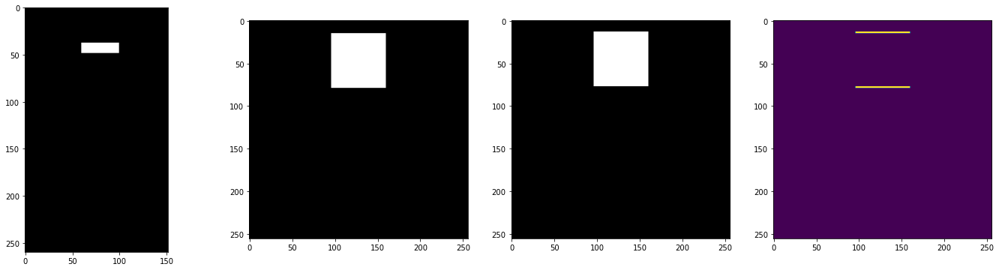

In [107]:
fig, ax = plt.subplots(1, 4, figsize=(24, 6))

src_img = np.zeros((260, 152, 3), np.uint8)
src_img[38:49, 60:100] = 255
src = np.array([(60, 38), (60, 49), (100, 49)], np.float32)
ax[0].imshow(src_img)

w, h = (64, 64)
x1 = int(img.shape[0]//2 - w/2)
y1 = 16
dst = np.array([(x1, y1), (x1,y1+h), (x1+w, y1+h)], dtype=np.float32)

tgt_img = np.zeros((256, 256, 3), np.uint8)
tgt_img[y1:y1+h, x1:x1+w, :] = 255
ax[1].imshow(tgt_img)

M = cv2.getAffineTransform(src, dst)
print("transformation matrix:")
print(M)
# Image.fromarray(src_img).transform((256, 256), Image.AFFINE, , Image.NEAREST)

trans_img = cv2.warpAffine(src_img, M, (256, 256), flags=cv2.INTER_NEAREST)
ax[2].imshow(trans_img)
print(np.abs(trans_img - tgt_img).sum())
print(np.unique(trans_img.reshape(-1, 1), axis=0))
ax[3].imshow(np.any((trans_img - tgt_img) != 0, axis=-1))
plt.show()

In [108]:
np.nonzero(np.any((trans_img - tgt_img) != 0, axis=-1).astype(int))

(array([14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14,
        14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14,
        14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14,
        14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 14, 15, 15, 15, 15,
        15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15,
        15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15,
        15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15, 15,
        15, 15, 15, 15, 15, 15, 15, 15, 15, 78, 78, 78, 78, 78, 78, 78, 78,
        78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78,
        78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78,
        78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78, 78,
        78, 78, 78, 78, 78, 79, 79, 79, 79, 79, 79, 79, 79, 79, 79, 79, 79,
        79, 79, 79, 79, 79, 79, 79, 79, 79, 79, 79, 79, 79, 79, 79, 79, 79,
        79, 

### Landmarks after affine transformation

In [31]:
np.array(ann['align_landmarks']).max()

1.0898696184158325

[[256.  64.]
 [256. 576.]
 [768. 576.]]


/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:42: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.


9


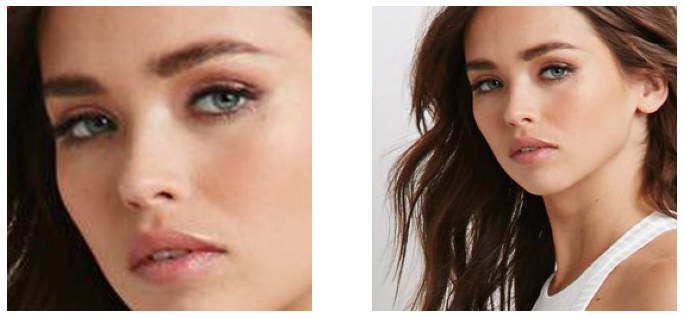

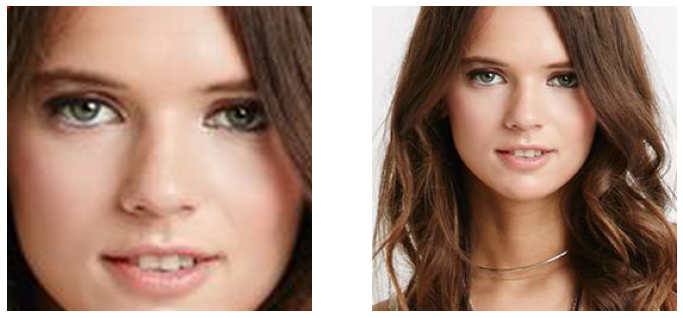

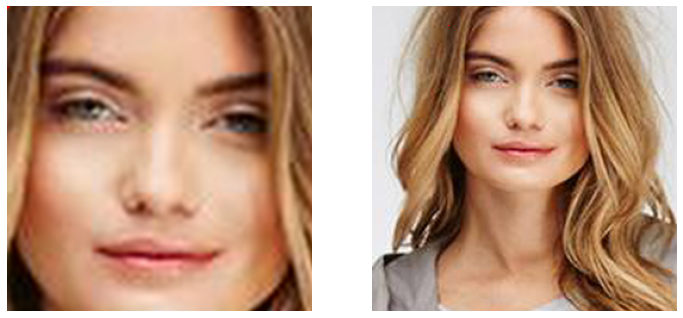

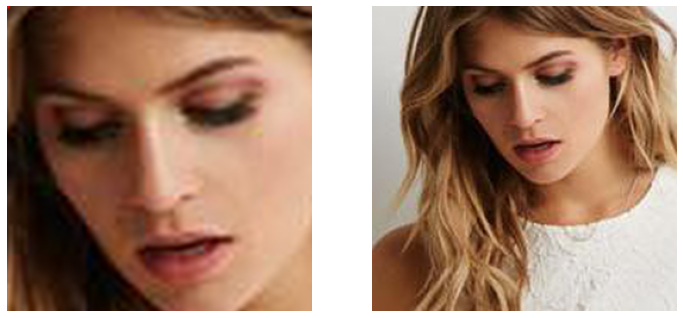

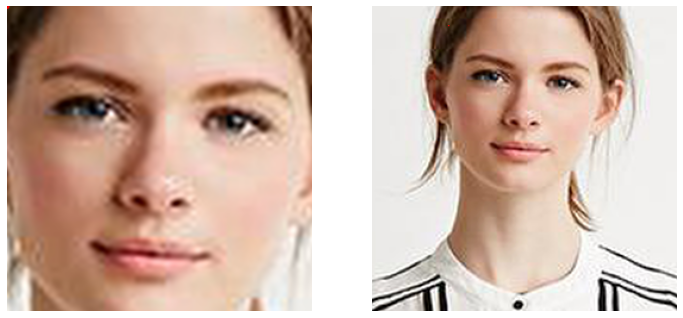

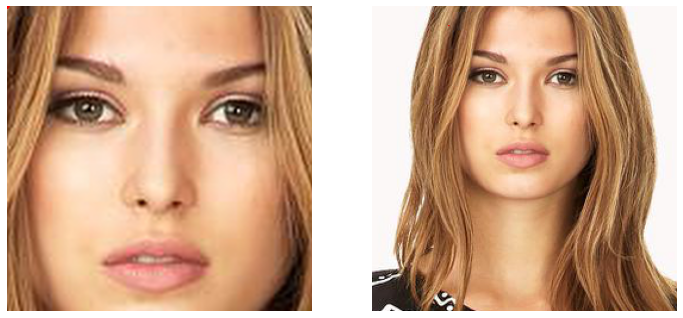

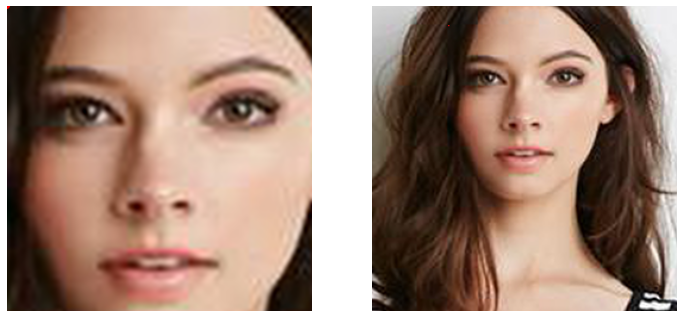

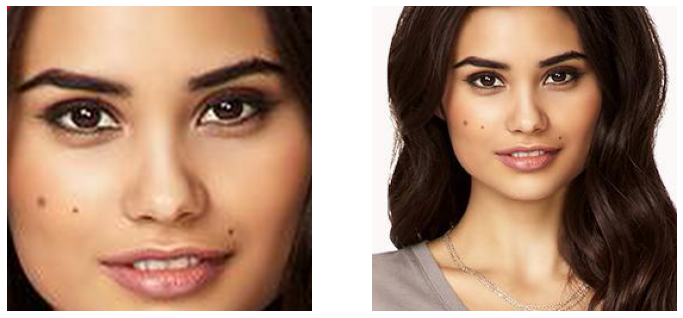

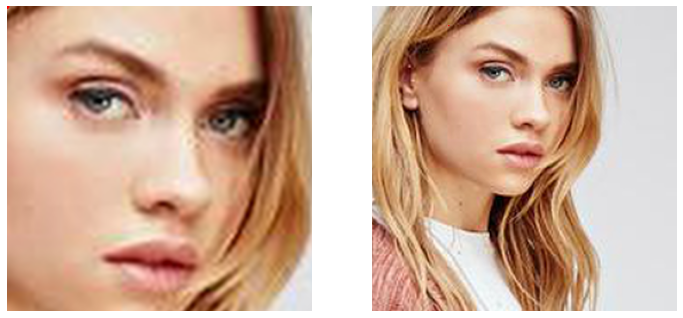

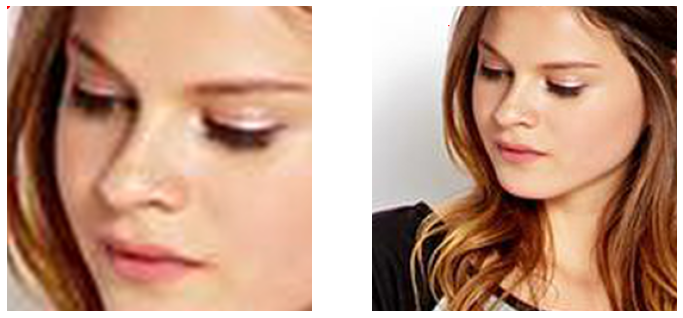

In [6]:
res = 1024
y1 = 64
ratio = 0.5

dst = np.array([(int(res/2 - (res*ratio / 2)), y1),
                (int(res/2 - (res*ratio / 2)), int(y1 + res * ratio)),
                (int(res/2 + (res*ratio / 2)), int(y1 + res * ratio))], np.float32)
print(dst)
i = 0
new_anns = {}
for i, (filename, ann) in enumerate(random.sample(anns.items(), 10)): # enumerate(anns.items()): #
    fig, axs = plt.subplots(1, 2, figsize=(12, 6))
    src_file = IMG_ROOT / f'{filename}.jpg'
    face, lm, square = recreate_aligned_images(
        src_file,
        ann,
        output_size=256,
        transform_size=1024,
        enable_padding=False,
        mask_mode='quad',
        ratio=1.0
    )
    img = io.imread(src_file)
    # display(Image.fromarray(img))
    src = np.array([tuple(square[0]), (square[0,0], square[1,1]), tuple(square[1])], dtype=np.float32)
    M = cv2.getAffineTransform(src, dst)
    lms = np.concatenate([lm, np.ones((lm.shape[0], 1), dtype=lm.dtype)], axis=1)
    lms = (np.concatenate([M, np.array([[0, 0, 1]], dtype=M.dtype)]) @ lms.T)[:2].T
    lms = (lms - dst[:1]) / 256
    ann['landmarks_unalign1.0'] = lms.tolist()
    trans_img = cv2.warpAffine(img, M, (res, res), flags=cv2.INTER_LANCZOS4, borderValue=(255, 255, 255))

    trans_face = trans_img[y1:int(y1 + res * ratio), int(res/2 - (res*ratio / 2)):int(res/2 + (res*ratio / 2))]
    for lm in lms:
        if (lm < 0).any() or (lm > 255).any():
            continue
        trans_face = cv2.circle(trans_face, tuple(lm.astype(int)), 2, (255, 0, 0), thickness=-1)
    axs[0].imshow(trans_face)
    axs[0].set_axis_off()
    axs[1].imshow(cv2.resize(trans_img, (256, 256), interpolation=cv2.INTER_CUBIC))
    axs[1].set_axis_off()
    fig.show()
    
    print(i, end='\r')
print(i)
# json.dump(anns, open('df_landmarks.json', 'w'))

In [ ]:
### Tune & Make dataset

In [4]:
64+256

320

In [3]:
res = 1024
y1 = 64
ratio = 0.5

dst = np.array([(int(res/2 - (res*ratio / 2)), y1),
                (int(res/2 - (res*ratio / 2)), int(y1 + res * ratio)),
                (int(res/2 + (res*ratio / 2)), int(y1 + res * ratio))], np.float32)
dst

array([[256.,  64.],
       [256., 576.],
       [768., 576.]], dtype=float32)

In [8]:
res = 1024
y1 = 64
ratio = 0.5

dst = np.array([(int(res/2 - (res*ratio / 2)), y1),
                (int(res/2 - (res*ratio / 2)), int(y1 + res * ratio)),
                (int(res/2 + (res*ratio / 2)), int(y1 + res * ratio))], np.float32)
print(dst)
# OUT_1024 = Path('r1024/fixed_face_position')
OUT_256 = Path(f'r256/fixedface_unalign1.0_{ratio}')
# OUT_face = Path('unalign_1.0/face')
# ori = []
# trans = []
i = non_square = 0
for filename, ann in anns.items(): # random.sample(anns.items(), 2):
    
    src_file = IMG_ROOT / f'{filename}.jpg'
    face, lm, square = recreate_aligned_images(
        src_file,
        ann,
        output_size=256,
        transform_size=1024,
        enable_padding=False,
        mask_mode='quad',
        ratio=1.0
    )
    img = io.imread(src_file)
    w, h = (square[1] - square[0]).tolist()
    if w != h or np.any(square < 0):
        # print(f"not square: {square.flatten()}")
        non_square += 1
        
#     ori.append(cv2.resize(img, (256, 256), interpolation=cv2.INTER_CUBIC))
    src = np.array([tuple(square[0]), (square[0,0], square[1,1]), tuple(square[1])], dtype=np.float32)
    M = cv2.getAffineTransform(src, dst)
    trans_img = cv2.warpAffine(img, M, (res, res), flags=cv2.INTER_NEAREST, borderValue=(255, 255, 255))
    
    #io.imsave(OUT_face / f'{filename}.png', trans_img[y1:int(y1 + res * ratio), int(res/2 - (res*ratio / 2)):int(res/2 + (res*ratio / 2))])
    #io.imsave(OUT_1024 / f'{filename}.png', trans_img)
    io.imsave(OUT_256 / f'{filename}.png', cv2.resize(trans_img, (256, 256), interpolation=cv2.INTER_CUBIC))
#     trans.append()
    # display(Image.fromarray(trans_img))
    i += 1
    print(f"{non_square} / {i}", end='\r')
print(f"{non_square} / {i}")

[[256.  64.]
 [256. 576.]
 [768. 576.]]
9264 / 27753


In [28]:
res = 1024
y1 = 64
ratio = 0.25

dst = np.array([(int(res/2 - (res*ratio / 2)), y1),
                (int(res/2 - (res*ratio / 2)), int(y1 + res * ratio)),
                (int(res/2 + (res*ratio / 2)), int(y1 + res * ratio))], np.float32)
print(dst)
OUT_1024 = Path('r1024/fixed_face_position')
OUT_256 = Path('r256/fixed_face_position')
OUT_face = Path('unalign_1.0/face')
OUT_PATCHES = [Path(f'unalign_1.0/slide_{i}') for i in range(1, 7)]
for p in OUT_PATCHES:
    if not p.exists():
        p.mkdir()

i = non_square = 0
for filename, ann in anns.items(): # random.sample(anns.items(), 2):
    
    src_file = IMG_ROOT / f'{filename}.jpg'
    face, lm, square = recreate_aligned_images(
        src_file,
        ann,
        output_size=256,
        transform_size=1024,
        enable_padding=False,
        mask_mode='quad',
        ratio=1.0
    )
    img = io.imread(src_file)
    w, h = (square[1] - square[0]).tolist()
    if w != h or np.any(square < 0):
        # print(f"not square: {square.flatten()}")
        non_square += 1
        
#     ori.append(cv2.resize(img, (256, 256), interpolation=cv2.INTER_CUBIC))
    src = np.array([tuple(square[0]), (square[0,0], square[1,1]), tuple(square[1])], dtype=np.float32)
    M = cv2.getAffineTransform(src, dst)
    trans_img = cv2.warpAffine(img, M, (res, res), flags=cv2.INTER_CUBIC, borderValue=(255, 255, 255))
    # display(Image.fromarray(trans_img))
    for s in range(1, 7):
        Image.fromarray(trans_img[y1 + s * 128:int(y1 + s * 128 + res * ratio), int(res/2 - (res*ratio / 2)):int(res/2 + (res*ratio / 2))]).save(OUT_PATCHES[s - 1] / f'{filename}.png')
    # display(Image.fromarray(trans_img[y1:int(y1 + res * ratio), int(res/2 - (res*ratio / 2)):int(res/2 + (res*ratio / 2))]))  # original
    # display(Image.fromarray(trans_img[y1:int(y1 + res * ratio), int(res/2 - (res*ratio)):int(res/2)]))
    # display(Image.fromarray(trans_img[y1:int(y1 + res * ratio), int(res/2):int(res/2 + (res*ratio))]))
    # display(Image.fromarray(trans_img[int(y1 + 0.5 * res * ratio):int(y1 + 1.5 * res * ratio), int(res/2 - (res*ratio / 2)):int(res/2 + (res*ratio / 2))]))
    #io.imsave(OUT_face / f'{filename}.png', trans_img[y1:int(y1 + res * ratio), int(res/2 - (res*ratio / 2)):int(res/2 + (res*ratio / 2))])
    #io.imsave(OUT_1024 / f'{filename}.png', trans_img)
    #io.imsave(OUT_256 / f'{filename}.png', cv2.resize(trans_img, (256, 256), interpolation=cv2.INTER_CUBIC))
#     trans.append()
    # display(Image.fromarray(trans_img))
    i += 1
    print(f"{non_square} / {i}", end='\r')
print(f"{non_square} / {i}")

[[384.  64.]
 [384. 320.]
 [640. 320.]]
9264 / 27753


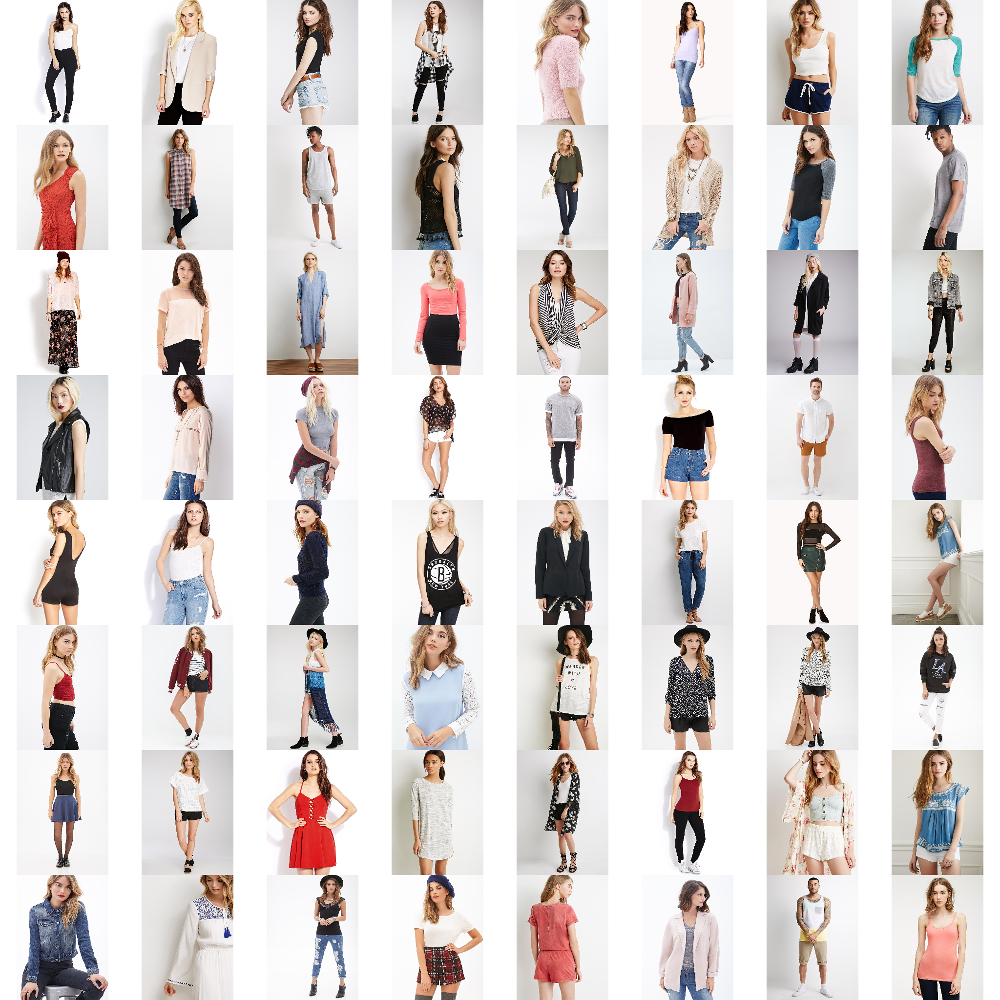

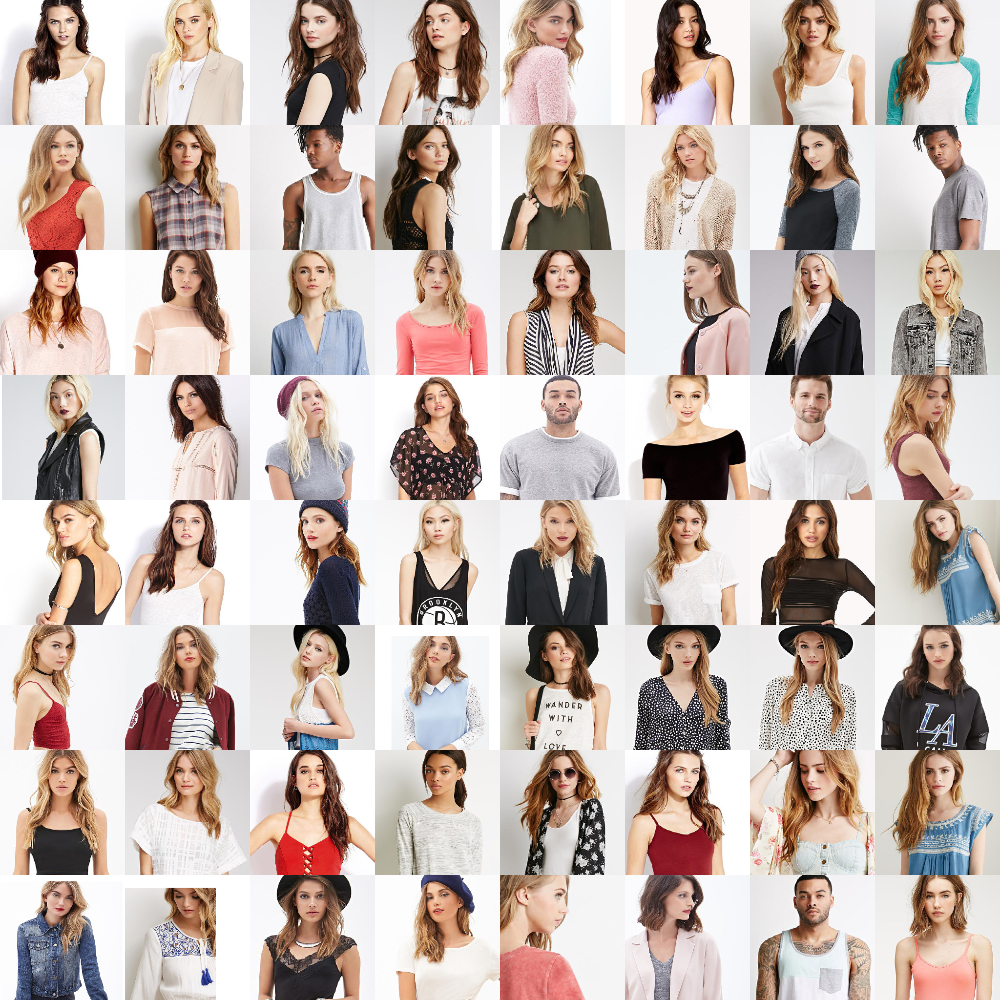

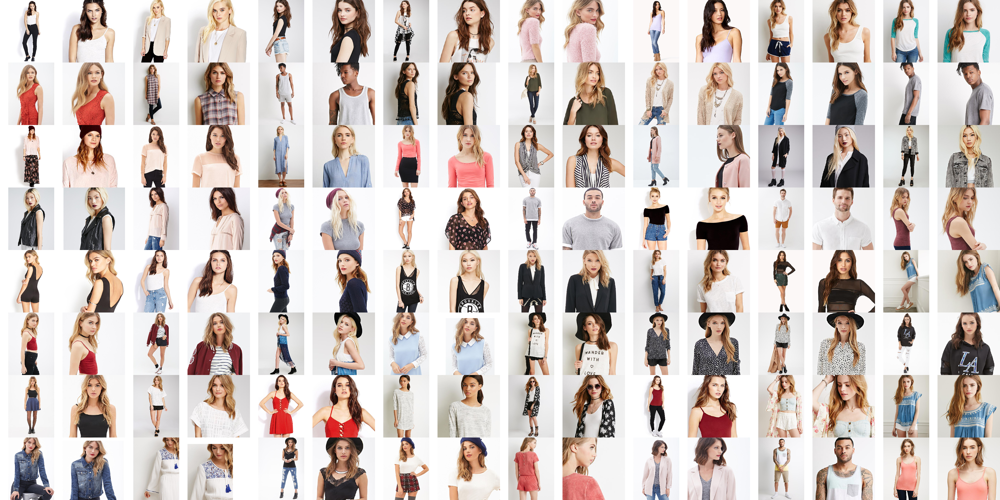

In [138]:
# Display image grids before and after warping face to fixed position
def gallery(array, ncols=3):
    nindex, height, width, intensity = array.shape
    nrows = nindex//ncols
    assert nindex == nrows*ncols
    # want result.shape = (height*nrows, width*ncols, intensity)
    result = (array.reshape(nrows, ncols, height, width, intensity)
              .swapaxes(1,2)
              .reshape(height*nrows, width*ncols, intensity))
    return result

ori_grid = Image.fromarray(gallery(np.array(ori), ncols=8))
ori_grid.save('align_to_fixed_pos-original.png')
display(ori_grid)
trans_grid = Image.fromarray(gallery(np.array(trans), ncols=8))
trans_grid.save('align_to_fixed_pos-trans.png')
display(trans_grid)
compare_grid = Image.fromarray(gallery(np.stack([np.array(ori), np.array(trans)], axis=1).reshape(128, 256, 256, 3), ncols=16))
compare_grid.save('align_to_fixed_pos-compare.png')
display(compare_grid)

### Sample dataset

/opt/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:8: UserWarning: Matplotlib is currently using module://ipykernel.pylab.backend_inline, which is a non-GUI backend, so cannot show the figure.
  


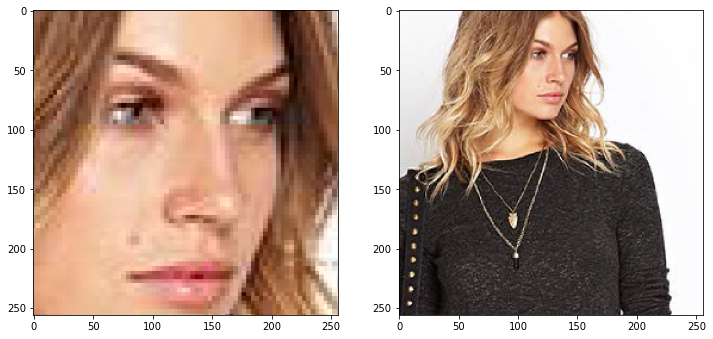

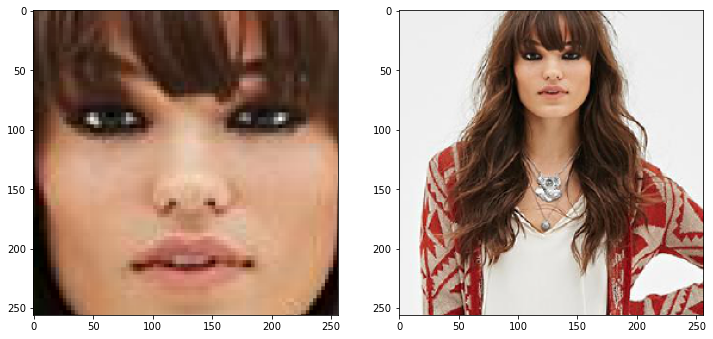

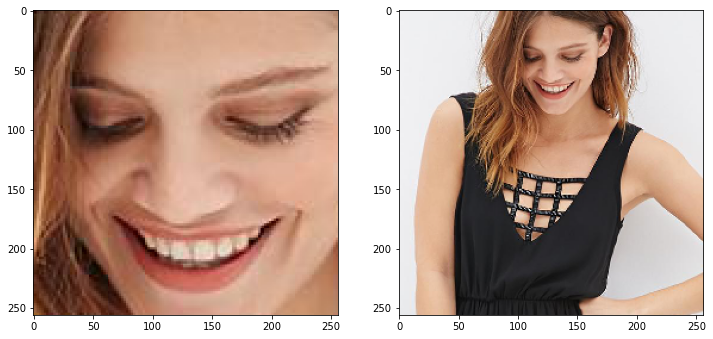

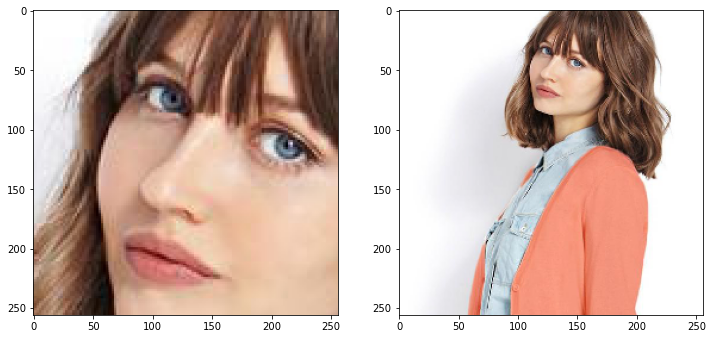

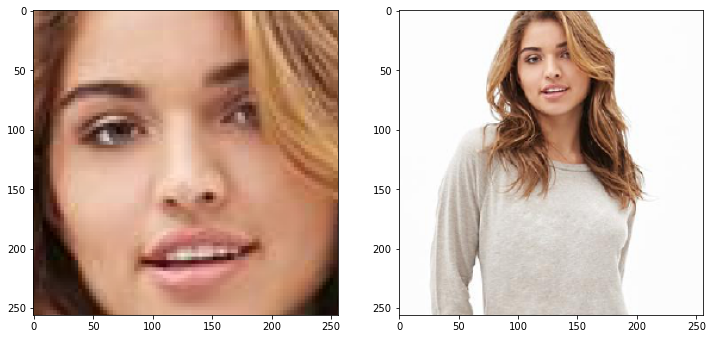

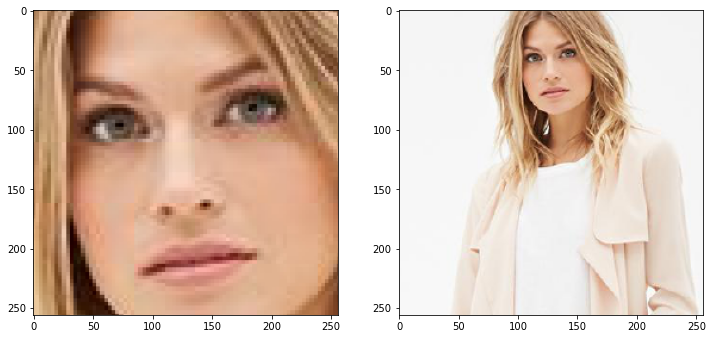

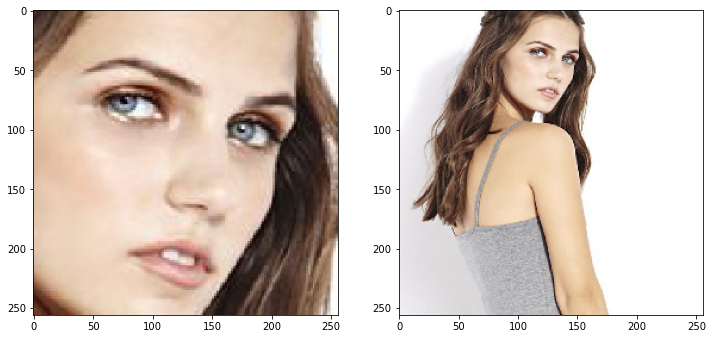

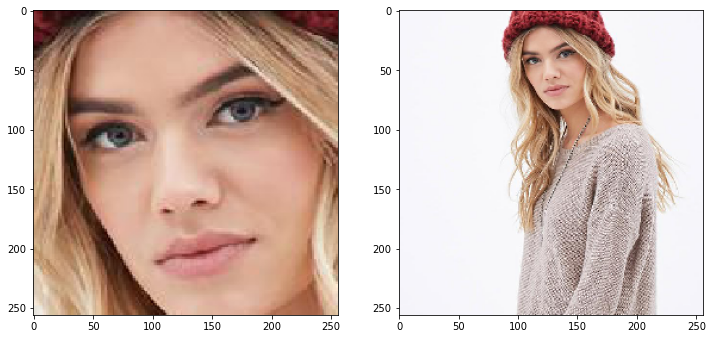

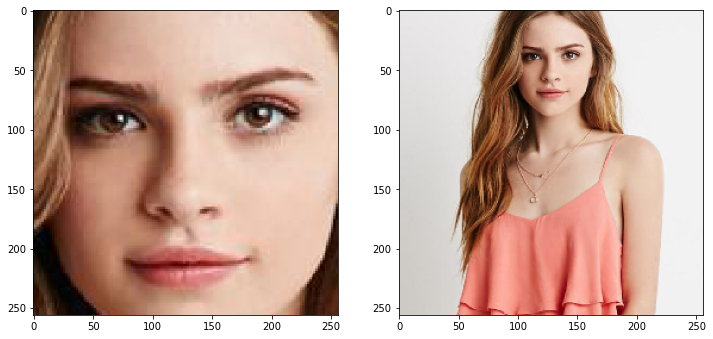

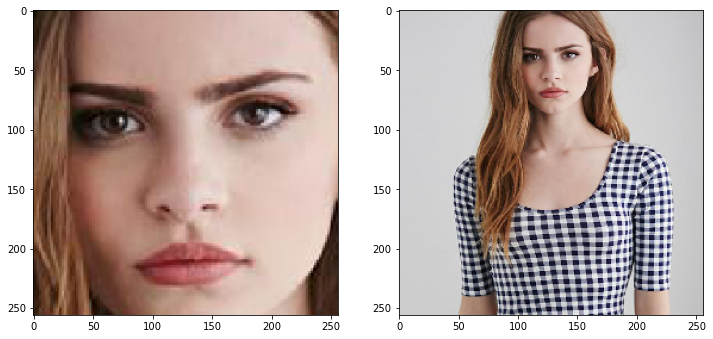

In [13]:
FACE_DIR = Path('unalign_1.0/face')
HUMAN_256 = Path('r256/fixed_face_position')
fileIDs = [x.stem for x in FACE_DIR.glob('*.png')]
for fileID in random.sample(fileIDs, 10):
    fig, ax = plt.subplots(1, 2, figsize=(12, 6))
    ax[0].imshow(io.imread(FACE_DIR / f'{fileID}.png'))
    ax[1].imshow(io.imread(HUMAN_256 / f'{fileID}.png'))
    fig.show()

In [6]:
refs = list(Path('unalign_1.0/face').glob('*.png'))
tgts = list(Path('r256/fixedface_unalign1.0_0.125/').glob('*.png'))
len(refs), len(tgts)

(27753, 27753)

$\frac{1}{16} * res + \frac{1}{2} * (ROI size)$